# Instructions

1. Download Dataset from the given link https://drive.google.com/drive/folders/1azHwIkIA3zIKgNIR6XNL3Iw5_sTttFbD?usp=sharing
 upload it to the google drive to folder named object_detection
2.Download All the files from this link https://github.com/Tony607/object_detection_demo and upload it to the same object_detection folder

3. replace this path /content/gdrive/My Drive/deep_learning/object_detection/ with your own object_detection.

#Notes

the data has manually split using a script available at https://drive.google.com/drive/folders/1azHwIkIA3zIKgNIR6XNL3Iw5_sTttFbD?usp=sharing. 



#Import



In [1]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


In [0]:
import os
import re

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [4]:
cd /content/gdrive/My Drive/deep_learning/object_detection/

/content/gdrive/My Drive/deep_learning/object_detection


In [0]:
# If you forked the repository, you can replace the link.
# repo_url = 'https://github.com/Tony607/object_detection_demo'
repo_url = '/content/gdrive/My Drive/deep_learning/object_detection/'

# Number of training steps.
num_steps = 1000  # 200000

# Number of evaluation steps.
num_eval_steps = 50

MODELS_CONFIG = {
    'ssd_mobilenet_v2': {
        'model_name': 'ssd_mobilenet_v2_coco_2018_03_29',
        'pipeline_file': 'ssd_mobilenet_v2_coco.config',
        'batch_size': 12
    },
    'faster_rcnn_inception_v2': {
        'model_name': 'faster_rcnn_inception_v2_coco_2018_01_28',
        'pipeline_file': 'faster_rcnn_inception_v2_pets.config',
        'batch_size': 12
    },
    'rfcn_resnet101': {
        'model_name': 'rfcn_resnet101_coco_2018_01_28',
        'pipeline_file': 'rfcn_resnet101_pets.config',
        'batch_size': 8
    }
}

# Pick the model you want to use

selected_model = 'faster_rcnn_inception_v2'

# Name of the object detection model to use.
MODEL = MODELS_CONFIG[selected_model]['model_name']

# Name of the pipline file in tensorflow object detection API.
pipeline_file = MODELS_CONFIG[selected_model]['pipeline_file']

# Training batch size fits in Colabe's Tesla K80 GPU memory for selected model.
batch_size = MODELS_CONFIG[selected_model]['batch_size']

In [6]:
# repo_dir_path = os.path.abspath(os.path.join('/', os.path.basename(repo_url)))
repo_dir_path = '/content/gdrive/My Drive/deep_learning/object_detection/'
# !git clone {repo_url}
%cd {repo_dir_path}
# !git pull

/content/gdrive/My Drive/deep_learning/object_detection


#Download Google Object Detection API and other dependencies

In [7]:
%cd /content
#!git clone --quiet https://github.com/tensorflow/models.git
!git clone --branch r1.13.0 --depth 1 https://github.com/tensorflow/models.git

!apt-get install -qq protobuf-compiler python-pil python-lxml python-tk

!pip install -q Cython contextlib2 pillow lxml matplotlib

!pip install -q pycocotools

%cd /content/models/research
!protoc object_detection/protos/*.proto --python_out=.

import os
os.environ['PYTHONPATH'] += ':/content/models/research/:/content/models/research/slim/'

!python object_detection/builders/model_builder_test.py

/content
Cloning into 'models'...
remote: Enumerating objects: 2927, done.
remote: Counting objects: 100% (2927/2927), done.
remote: Compressing objects: 100% (2449/2449), done.
remote: Total 2927 (delta 509), reused 2035 (delta 403), pack-reused 0
Receiving objects: 100% (2927/2927), 369.04 MiB | 15.08 MiB/s, done.
Resolving deltas: 100% (509/509), done.
Checking out files: 100% (2768/2768), done.
Selecting previously unselected package python-bs4.
(Reading database ... 144467 files and directories currently installed.)
Preparing to unpack .../0-python-bs4_4.6.0-1_all.deb ...
Unpacking python-bs4 (4.6.0-1) ...
Selecting previously unselected package python-pkg-resources.
Preparing to unpack .../1-python-pkg-resources_39.0.1-2_all.deb ...
Unpacking python-pkg-resources (39.0.1-2) ...
Selecting previously unselected package python-chardet.
Preparing to unpack .../2-python-chardet_3.0.4-1_all.deb ...
Unpacking python-chardet (3.0.4-1) ...
Selecting previously unselected package python-si

#Conversion of XML annotations and images into tfrecords for training and testing datasets

In [8]:
cd /content/gdrive/My Drive/deep_learning/object_detection/

/content/gdrive/My Drive/deep_learning/object_detection


In [0]:
path = '/content/gdrive/My Drive/deep_learning/object_detection/'

In [0]:
%cd {repo_dir_path}

## WRITE YOUR CODE HERE ##
# Convert train folder annotation xml files to a single csv file,
# generate the `label_map.pbtxt` file to `data/` directory as well.
#-->
!python xml_to_csv.py -i train -o annotations_2/train_labels.csv -l annotations_2
# Convert test folder annotation xml files to a single csv.
#-->
!python xml_to_csv.py -i test -o annotations_2/test_labels.csv
# Generate `train.record`
#-->
!python generate_tfrecord.py --csv_input=annotations_2/train_labels.csv --output_path=annotations_2/train.record --img_path=train --label_map annotations_2/label_map.pbtxt
# Generate `test.record`
#-->
!python generate_tfrecord.py --csv_input=annotations_2/test_labels.csv --output_path=annotations_2/test.record --img_path=test --label_map annotations_2/label_map.pbtxt

## END YOUR CODE HERE ##

/content/gdrive/My Drive/deep_learning/object_detection
Successfully converted xml to csv.
Generate `annotations_2/label_map.pbtxt`
Successfully converted xml to csv.


W0606 16:21:56.441400 140204007626624 module_wrapper.py:139] From generate_tfrecord.py:107: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W0606 16:21:56.454854 140204007626624 module_wrapper.py:139] From /content/models/research/object_detection/utils/label_map_util.py:132: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/gdrive/My Drive/deep_learning/object_detection/annotations_2/train.record


W0606 16:22:00.995877 140003541641088 module_wrapper.py:139] From generate_tfrecord.py:107: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W0606 16:22:01.006027 140003541641088 module_wrapper.py:139] From /content/models/research/object_detection/utils/label_m

In [0]:
test_record_fname = '/content/gdrive/My Drive/deep_learning/object_detection/annotations_2/test.record'
train_record_fname = '/content/gdrive/My Drive/deep_learning/object_detection/annotations_2/train.record'
label_map_pbtxt_fname = '/content/gdrive/My Drive/deep_learning/object_detection/annotations_2/label_map.pbtxt'

#Download the base model for transfer learning

In [11]:
%cd /content/models/research

import os
import shutil
import glob
import urllib.request
import tarfile
MODEL_FILE = MODEL + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'
DEST_DIR = '/content/models/research/pretrained_model'

if not (os.path.exists(MODEL_FILE)):
    urllib.request.urlretrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)

tar = tarfile.open(MODEL_FILE)
tar.extractall()
tar.close()

os.remove(MODEL_FILE)
if (os.path.exists(DEST_DIR)):
    shutil.rmtree(DEST_DIR)
os.rename(MODEL, DEST_DIR)

/content/models/research


In [12]:
!echo {DEST_DIR}
!ls -alh {DEST_DIR}

/content/models/research/pretrained_model
total 111M
drwxr-xr-x  3 345018 5000 4.0K Feb  1  2018 .
drwxr-xr-x 70 root   root 4.0K Jun 10 11:40 ..
-rw-r--r--  1 345018 5000   77 Feb  1  2018 checkpoint
-rw-r--r--  1 345018 5000  55M Feb  1  2018 frozen_inference_graph.pb
-rw-r--r--  1 345018 5000  51M Feb  1  2018 model.ckpt.data-00000-of-00001
-rw-r--r--  1 345018 5000  16K Feb  1  2018 model.ckpt.index
-rw-r--r--  1 345018 5000 5.5M Feb  1  2018 model.ckpt.meta
-rw-r--r--  1 345018 5000 3.2K Feb  1  2018 pipeline.config
drwxr-xr-x  3 345018 5000 4.0K Feb  1  2018 saved_model


In [13]:
fine_tune_checkpoint = os.path.join(DEST_DIR, "model.ckpt")
fine_tune_checkpoint

'/content/models/research/pretrained_model/model.ckpt'

#Training: Transfer learning from already trained models



In [0]:
import os
pipeline_fname = os.path.join('/content/models/research/object_detection/samples/configs/', pipeline_file)

assert os.path.isfile(pipeline_fname), '`{}` not exist'.format(pipeline_fname)

In [0]:
def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())

In [16]:
num_classes = get_num_classes(label_map_pbtxt_fname)
with open(pipeline_fname) as f:
    s = f.read()
with open(pipeline_fname, 'w') as f:
    
    # fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)
    
    # tfrecord files train and test.
    s = re.sub(
        '(input_path: ".*?)(train.record)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(val.record)(.*?")', 'input_path: "{}"'.format(test_record_fname), s)

    # label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)
    
    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)
    f.write(s)

In [17]:
!cat {pipeline_fname}

# Faster R-CNN with Inception v2, configured for Oxford-IIIT Pets Dataset.
# Users should configure the fine_tune_checkpoint field in the train config as
# well as the label_map_path and input_path fields in the train_input_reader and
# eval_input_reader. Search for "PATH_TO_BE_CONFIGURED" to find the fields that
# should be configured.

model {
  faster_rcnn {
    num_classes: 1
    image_resizer {
      keep_aspect_ratio_resizer {
        min_dimension: 600
        max_dimension: 1024
      }
    }
    feature_extractor {
      type: 'faster_rcnn_inception_v2'
      first_stage_features_stride: 16
    }
    first_stage_anchor_generator {
      grid_anchor_generator {
        scales: [0.25, 0.5, 1.0, 2.0]
        aspect_ratios: [0.5, 1.0, 2.0]
        height_stride: 16
        width_stride: 16
      }
    }
    first_stage_box_predictor_conv_hyperparams {
      op: CONV
      regularizer {
        l2_regularizer {
          weight: 0.0
        }
      }
      initializer {
        tru

In [0]:
model_dir = 'training/'
# Optionally remove content in output model directory to fresh start.
!rm -rf {model_dir}
os.makedirs(model_dir, exist_ok=True)

#Install Tensorboard to visualize the progress of training process

In [19]:
!wget https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
!unzip -o ngrok-stable-linux-amd64.zip

--2020-06-10 11:07:22--  https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
Resolving bin.equinox.io (bin.equinox.io)... 107.21.11.91, 50.16.94.112, 52.206.116.16, ...
Connecting to bin.equinox.io (bin.equinox.io)|107.21.11.91|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13773305 (13M) [application/octet-stream]
Saving to: ‘ngrok-stable-linux-amd64.zip’

ngrok-stable-linux- 100%[===================>]  13.13M  16.9MB/s    in 0.8s    

2020-06-10 11:07:23 (16.9 MB/s) - ‘ngrok-stable-linux-amd64.zip’ saved [13773305/13773305]

Archive:  ngrok-stable-linux-amd64.zip
  inflating: ngrok                   


In [0]:
LOG_DIR = model_dir
get_ipython().system_raw(
    'tensorboard --logdir {} --host 0.0.0.0 --port 6006 &'
    .format(LOG_DIR)
)

In [0]:
get_ipython().system_raw('./ngrok http 6006 &')


In [22]:
! curl -s http://localhost:4040/api/tunnels | python3 -c \
    "import sys, json; print(json.load(sys.stdin)['tunnels'][0]['public_url'])"

http://6821dc6716db.ngrok.io


#Training the model

In [21]:
# If this doesnot complete 1000 Steps, run it again until it finishes 1000 steps
!python /content/models/research/object_detection/model_main.py \
    --pipeline_config_path={pipeline_fname} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --num_eval_steps={num_eval_steps}

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.





W0610 12:09:36.376498 139907295991680 module_wrapper.py:139] From /content/models/research/object_detection/utils/config_util.py:94: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.


W0610 12:09:36.378999 139907295991680 module_wrapper.py:139] From /content/models/research/object_detection/model_lib.py:573: The name tf.logging.warning is deprecated. Please use tf.compat.v1.logging.warning instead.

W0610 12:09:36.379130 139907295991680 model_lib.py:574] Forced number of epochs for all eval validations to be 1.

W0610 12:09:36.379244 139907295991680 module_wrapper.py:139] From /content/models/rese

In [22]:
!ls {model_dir}

checkpoint				     model.ckpt-1000.index
events.out.tfevents.1591789280.f61982783463  model.ckpt-1000.meta
events.out.tfevents.1591790161.f61982783463  model.ckpt-397.data-00000-of-00001
events.out.tfevents.1591790993.f61982783463  model.ckpt-397.index
graph.pbtxt				     model.ckpt-397.meta
model.ckpt-0.data-00000-of-00001	     model.ckpt-790.data-00000-of-00001
model.ckpt-0.index			     model.ckpt-790.index
model.ckpt-0.meta			     model.ckpt-790.meta
model.ckpt-1000.data-00000-of-00001


#Exporting a Trained Inference Graph

In [23]:
import re
import numpy as np

output_directory = './fine_tuned_model'

lst = os.listdir(model_dir)
lst = [l for l in lst if 'model.ckpt-' in l and '.meta' in l]
steps=np.array([int(re.findall('\d+', l)[0]) for l in lst])
last_model = lst[steps.argmax()].replace('.meta', '')

last_model_path = os.path.join(model_dir, last_model)
print(last_model_path)
!python /content/models/research/object_detection/export_inference_graph.py \
    --input_type=image_tensor \
    --pipeline_config_path={pipeline_fname} \
    --output_directory={output_directory} \
    --trained_checkpoint_prefix={last_model_path}

training/model.ckpt-1000
The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.





W0610 12:28:22.983380 140631065696128 module_wrapper.py:139] From /content/models/research/object_detection/export_inference_graph.py:133: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Instructions for updating:
Use `tf.cast` instead.
W0610 12:28:22.988724 140631065696128 deprecation.py:323] From /content/models/research/object_detection/anchor_generators/grid_anchor_generator.py:59: to_float (from tensorflow.python.ops.math_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use `tf.cast` instead.

W0610 12:28:22.991956 1406310656961

In [24]:
!ls {output_directory}

checkpoint			model.ckpt.index  saved_model
frozen_inference_graph.pb	model.ckpt.meta
model.ckpt.data-00000-of-00001	pipeline.config


#Use frozen model for inference.

In [0]:
import os

pb_fname = os.path.join(os.path.abspath(output_directory), "frozen_inference_graph.pb")
assert os.path.isfile(pb_fname), '`{}` not exist'.format(pb_fname)

In [26]:
!ls -alh {pb_fname}

-rw-r--r-- 1 root root 50M Jun 10 12:28 /content/models/research/fine_tuned_model/frozen_inference_graph.pb


In [27]:
import os
import glob

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = pb_fname

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = label_map_pbtxt_fname

# If you want to test the code with your images, just add images files to the PATH_TO_TEST_IMAGES_DIR.
PATH_TO_TEST_IMAGES_DIR =  os.path.join(repo_dir_path, "test")

assert os.path.isfile(pb_fname)
assert os.path.isfile(PATH_TO_LABELS)
TEST_IMAGE_PATHS = glob.glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, "*.jpeg*"))
assert len(TEST_IMAGE_PATHS) > 0, 'No image found in `{}`.'.format(PATH_TO_TEST_IMAGES_DIR)
print(TEST_IMAGE_PATHS)

['/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00046.jpeg', '/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00007.jpeg', '/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00033.jpeg', '/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00040.jpeg', '/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00050.jpeg', '/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00036.jpeg', '/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00015.jpeg', '/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00049.jpeg', '/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00073.jpeg', '/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00068.jpeg', '/content/gdrive/My Drive/deep_learning/object_detection/test/BloodImage_00023.jpeg', '/content/gdrive/My Drive/deep_learning/object_detect

# Visualization

/content/models/research/object_detection


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:128: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


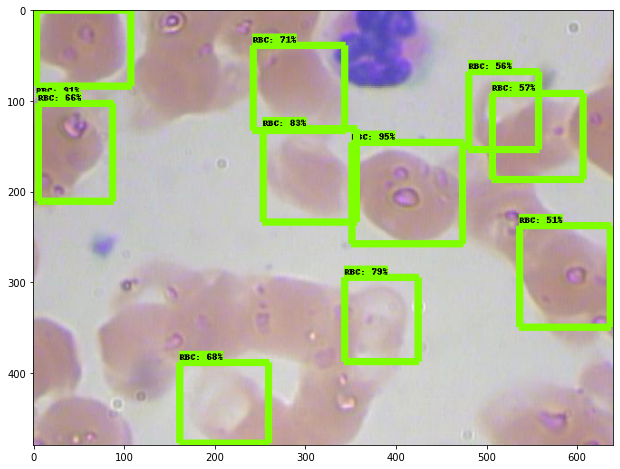

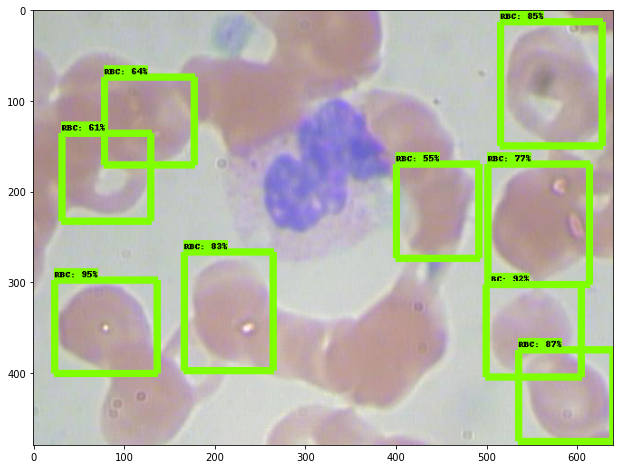

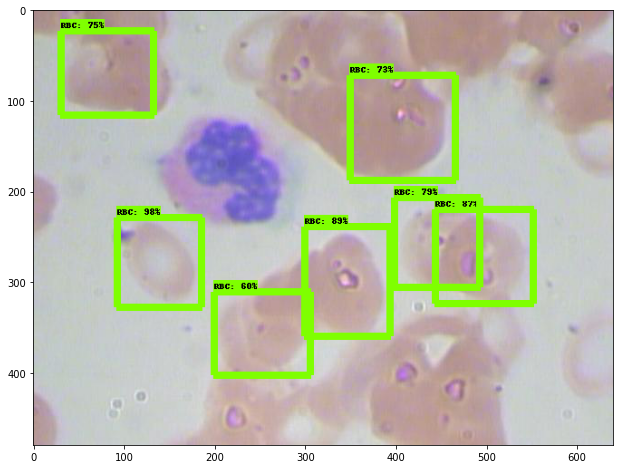

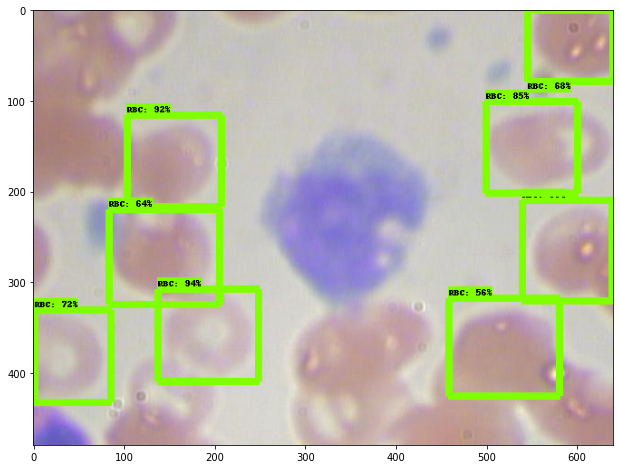

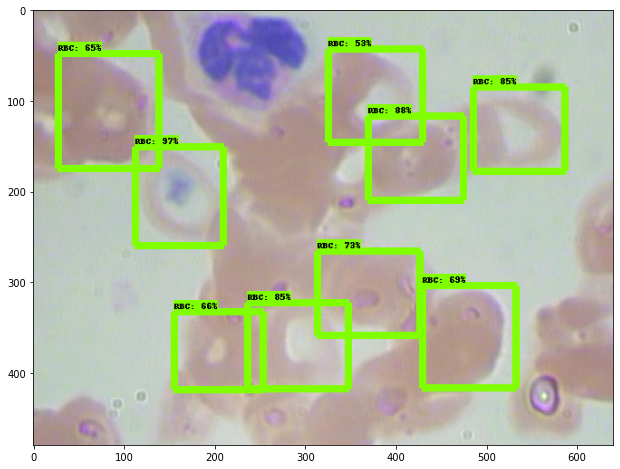

...

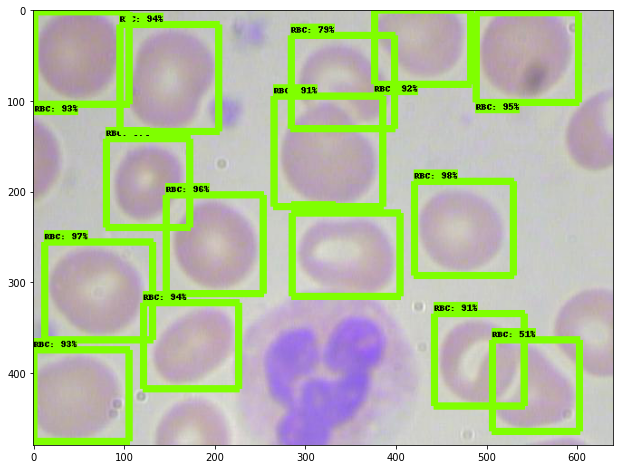

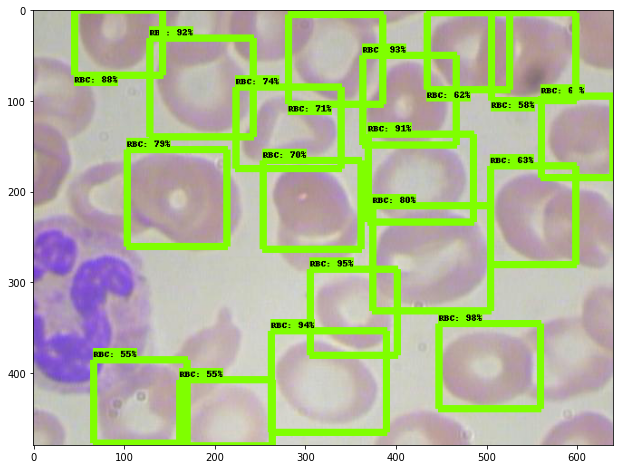

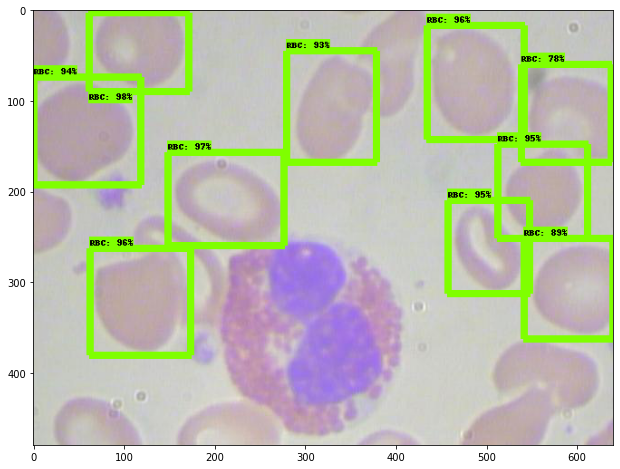

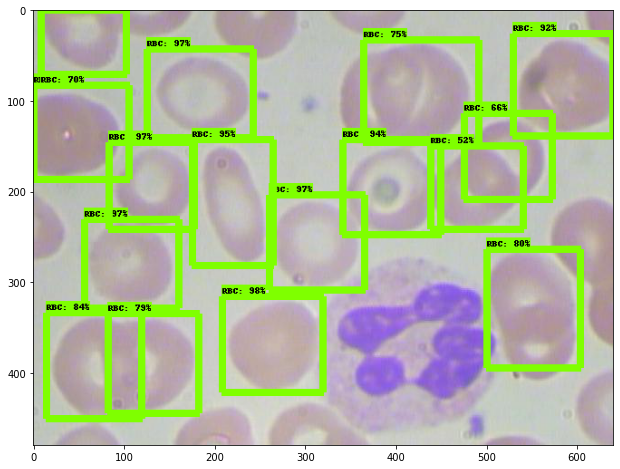

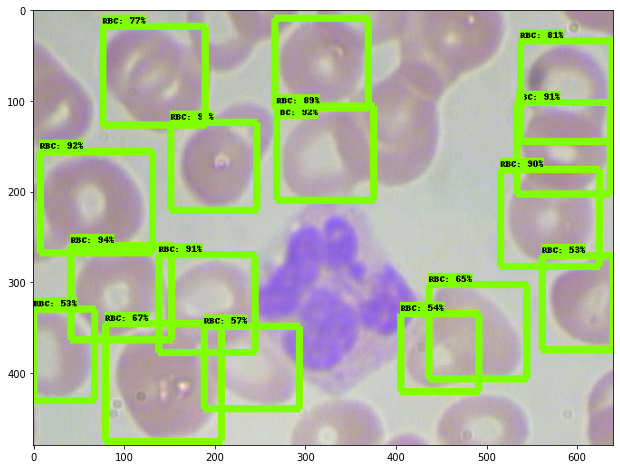

In [29]:
%cd /content/models/research/object_detection

import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops


# This is needed to display the images.
%matplotlib inline


from object_detection.utils import label_map_util

from object_detection.utils import visualization_utils as vis_util


detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')


label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=num_classes, use_display_name=True)
category_index = label_map_util.create_category_index(categories)


def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)


def run_inference_for_single_image(image, graph):
    with graph.as_default():
        with tf.Session() as sess:
            # Get handles to input and output tensors
            ops = tf.get_default_graph().get_operations()
            all_tensor_names = {
                output.name for op in ops for output in op.outputs}
            tensor_dict = {}
            for key in [
                'num_detections', 'detection_boxes', 'detection_scores',
                'detection_classes', 'detection_masks'
            ]:
                tensor_name = key + ':0'
                if tensor_name in all_tensor_names:
                    tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
                        tensor_name)
            if 'detection_masks' in tensor_dict:
                # The following processing is only for single image
                detection_boxes = tf.squeeze(
                    tensor_dict['detection_boxes'], [0])
                detection_masks = tf.squeeze(
                    tensor_dict['detection_masks'], [0])
                # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
                real_num_detection = tf.cast(
                    tensor_dict['num_detections'][0], tf.int32)
                detection_boxes = tf.slice(detection_boxes, [0, 0], [
                                           real_num_detection, -1])
                detection_masks = tf.slice(detection_masks, [0, 0, 0], [
                                           real_num_detection, -1, -1])
                detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
                    detection_masks, detection_boxes, image.shape[0], image.shape[1])
                detection_masks_reframed = tf.cast(
                    tf.greater(detection_masks_reframed, 0.5), tf.uint8)
                # Follow the convention by adding back the batch dimension
                tensor_dict['detection_masks'] = tf.expand_dims(
                    detection_masks_reframed, 0)
            image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

            # Run inference
            output_dict = sess.run(tensor_dict,
                                   feed_dict={image_tensor: np.expand_dims(image, 0)})

            # all outputs are float32 numpy arrays, so convert types as appropriate
            output_dict['num_detections'] = int(
                output_dict['num_detections'][0])
            output_dict['detection_classes'] = output_dict[
                'detection_classes'][0].astype(np.uint8)
            output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
            output_dict['detection_scores'] = output_dict['detection_scores'][0]
            if 'detection_masks' in output_dict:
                output_dict['detection_masks'] = output_dict['detection_masks'][0]
    return output_dict

map2=[]

for image_path in TEST_IMAGE_PATHS:
    image = Image.open(image_path)
    # the array based representation of the image will be used later in order to prepare the
    # result image with boxes and labels on it.
    image_np = load_image_into_numpy_array(image)
    # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
    image_np_expanded = np.expand_dims(image_np, axis=0)
    # Actual detection.
    output_dict = run_inference_for_single_image(image_np, detection_graph)
    # Visualization of the results of a detection.
    vis_util.visualize_boxes_and_labels_on_image_array(
        image_np,
        output_dict['detection_boxes'],
        output_dict['detection_classes'],
        output_dict['detection_scores'],
        category_index,
        instance_masks=output_dict.get('detection_masks'),
        use_normalized_coordinates=True,
        line_thickness=8)
    plt.figure(figsize=IMAGE_SIZE)
    plt.imshow(image_np)
    for j in output_dict['detection_scores']: #for calculating mAP
      if j >=0.5:
        map2.append(j)

#mAP

In [30]:
print(map2)

[0.9574804, 0.91326404, 0.8399862, 0.79170823, 0.7129367, 0.6873715, 0.6619626, 0.5717951, 0.56490576, 0.5105668, 0.9537163, 0.92696756, 0.87912756, 0.8593811, 0.8391345, 0.7779891, 0.6413719, 0.6162126, 0.55221945, 0.9855795, 0.8999307, 0.8797768, 0.79368263, 0.754845, 0.7388782, 0.6067475, 0.9477357, 0.9202616, 0.88590634, 0.85087323, 0.7297911, 0.6834933, 0.647618, 0.5673698, 0.9746814, 0.8858029, 0.8515066, 0.8508589, 0.73103017, 0.6986666, 0.662473, 0.6546608, 0.5374823, 0.9654667, 0.9413638, 0.93294984, 0.9327913, 0.8598597, 0.73507446, 0.57221496, 0.9680669, 0.9619298, 0.92593825, 0.9245537, 0.90801394, 0.8475337, 0.8237264, 0.82040095, 0.7692643, 0.7689187, 0.60790396, 0.59837806, 0.5737986, 0.5200053, 0.5092658, 0.95971906, 0.95339584, 0.9104726, 0.89213616, 0.8733385, 0.81763035, 0.80754465, 0.77919734, 0.7488789, 0.651291, 0.93285716, 0.9316749, 0.92737496, 0.9215369, 0.8560466, 0.80719495, 0.7795635, 0.6173219, 0.9912196, 0.9862939, 0.9745959, 0.9318219, 0.86967534, 0.85958

In [31]:
mapx = np.average(map2)
print("mAP of the model Faster RCNN is {}".format(mapx))

mAP of the model Faster RCNN is 0.8303371071815491
